# CME538 Big Project: Analysis Code
### Topic: Investigating the Energy Intensity of Large Buildings in Toronto

Team Capybara: Chaitanya Ahuja, Zere Bekzhanova, Steffany Lung, and Ruoxuan Wu


## A. Import Modules

In [1]:
import numpy as np
import pandas as pd
import geopandas as gpd
import seaborn as sns
import matplotlib.pylab as plt
import folium
from folium import Choropleth
from shapely.ops import unary_union

## B. Prepare Datasets
### 1. Area Code Geodata

In [2]:
# Read Ontario postal code boundaries as a GeoDataFrame
postal_boundaries = gpd.read_file('ONldu.shp')
postal_boundaries.head()

,PCA_ID,POSTALCODE,PROV,MAF_ID,PREC_CODE,PCA_COUNT,DOM_PCA,MULTI_PC,DEL_M_ID,LONGITUDE,LATITUDE,geometry
0,180000001,L4S1M4,ON,350005325,2,2,0,0,SS0315,-79.415566,43.894633,"POLYGON ((-79.41532 43.89477, -79.41524 43.894..."
1,180000002,K1Y3R6,ON,350002120,2,1,1,0,LC0011,-75.721267,45.398581,"POLYGON ((-75.72044 45.39871, -75.72055 45.398..."
2,180000003,L4S1M5,ON,350005325,2,1,1,0,SS0315,-79.401105,43.900182,"POLYGON ((-79.39646 43.90124, -79.39635 43.900..."
3,180000004,L4S1M6,ON,350005325,2,1,1,0,None,-79.389156,43.901523,"POLYGON ((-79.38926 43.90014, -79.38956 43.900..."
4,180000005,L4S1M7,ON,350005325,2,3,0,0,SS0315,-79.415879,43.892396,"POLYGON ((-79.41526 43.89340, -79.41523 43.893..."


In [3]:
# Clean up postal code data & extract Toronto data only
to_postal_boundaries = postal_boundaries.copy()
to_postal_boundaries = to_postal_boundaries.to_crs(epsg=2957) # Set common coordinate referencing system
to_postal_boundaries = to_postal_boundaries[to_postal_boundaries['POSTALCODE'].str[0] == 'M'] # Toronto postal codes begin with 'M'
to_postal_boundaries['area_code'] = to_postal_boundaries['POSTALCODE'].str[0:3] # Add a column for three-letter postal code
to_postal_boundaries = to_postal_boundaries[['POSTALCODE','area_code','geometry']] # Extract needed columns
to_postal_boundaries.head()

,POSTALCODE,area_code,geometry
182147,M1B0A1,M1B,"POLYGON ((2573570.360 5182897.340, 2573538.622..."
182154,M1B0A2,M1B,"POLYGON ((2573468.211 5185923.149, 2573453.910..."
182159,M1B0A3,M1B,"POLYGON ((2580080.393 5185653.747, 2580066.983..."
182166,M1B0A3,M1B,"POLYGON ((2580035.452 5185747.584, 2580055.010..."
182172,M1B0A4,M1B,"POLYGON ((2580056.189 5185763.038, 2580035.452..."


In [4]:
# Create empty lists to store three-letter postal codes and geometries
area_codes = []
geometries = []

# Use the unary_union module from shapely.ops to combine geometries for each three-letter postal code region
for pc in pd.unique(to_postal_boundaries['area_code']):
    area_codes.append(pc)
    geometries.append(unary_union(to_postal_boundaries[to_postal_boundaries['area_code']==pc]['geometry']))

# Convert the area code boundaries to GeoDataFrame and set crs
area_code_boundaries = gpd.GeoDataFrame({'area_code': area_codes, 'geometry': geometries})
area_code_boundaries.crs = "EPSG:2957" # Toronto's EPSG is 2957
area_code_boundaries.head()

,area_code,geometry
0,M1B,"MULTIPOLYGON (((2573478.556 5183018.874, 25734..."
1,M1C,"MULTIPOLYGON (((2577398.285 5183358.566, 25773..."
2,M1E,"MULTIPOLYGON (((2557649.519 5162469.693, 25576..."
3,M1G,"MULTIPOLYGON (((2574948.387 5180881.153, 25749..."
4,M1H,"MULTIPOLYGON (((2573492.408 5179906.718, 25734..."


In [5]:
# Write to csv if desired
area_code_boundaries.to_csv('postal_boundaries.csv')

## 2. Building Energy Data

In [7]:
# Read Toronto large building data as a GeoDataFrame
building_energy = pd.read_excel('ewrb_odc_data_prep_2022_updated_sept_28_2023.xlsx')
building_energy.head()

,EWRB_ID,City,Postal_Code,PrimPropTypCalc,PrimPropTypSelf,Largest_PropTyp,All_Prop_Types,Thrd_Party_Cert,WN_Sit_Elc_Int1,WN_Sit_Elc_Int2,...,WN_Site_EUI1,WN_Site_EUI2,WN_Source_EUI1,WN_Source_EUI2,GHG_Emiss_Int1,GHG_Emiss_Int2,Ener_Star_Score,Ener_Star_Certs,Data_Qual_Check,Data_Qual_Date
0,100037,Hawkesbury,K6A,Retail Store,Strip Mall,Retail Store,Retail Store,Not Available,0.612251,15.8,...,1.01293,26.14,1.60348,41.38,22.604213,2.1,Not Available,Not Available,Yes,2022-06-28
1,100066,Rockland,K4K,Strip Mall,Strip Mall,Strip Mall,Strip Mall,Not Available,0.705251,18.2,...,1.31518,33.94,1.99757,51.55,30.138951,2.8,Not Available,Not Available,No,Not Available
2,100088,Cornwall,K6H,Convention Center,Convention Center,Convention Center,"Convention Center, Parking",Not Available,0.670376,17.3,...,1.054,27.2,1.69997,43.87,23.680604,2.2,Not Available,Not Available,No,Not Available
3,100099,Cornwall,K6H,Multifamily Housing,Multifamily Housing,Multifamily Housing,"Multifamily Housing, Parking",Not Available,0.441751,11.4,...,0.566526,14.62,0.991615,25.59,9.687520,0.9,60,Not Available,No,Not Available
4,100101,Cornwall,K6H,Strip Mall,Strip Mall,Strip Mall,Strip Mall,Matt Morris P. Eng.,0.2325,6,...,0.792827,20.46,1.02106,26.35,26.909778,2.5,Not Available,Not Available,Yes,2022-06-30


In [8]:
# Extract the needed building energy columns for Toronto only
building_energy_filt = building_energy[['City','Postal_Code','PrimPropTypCalc','WN_Sit_Elc_Int1','WN_Sit_Gas_Int1','GHG_Emiss_Int1','Ener_Star_Score']]
building_energy_filt = building_energy_filt[building_energy_filt['Postal_Code'].str[0]=='M'] # Toronto postal codes begin with 'M'
building_energy_filt.reset_index(inplace=True, drop=True)
building_energy_filt.head()

,City,Postal_Code,PrimPropTypCalc,WN_Sit_Elc_Int1,WN_Sit_Gas_Int1,GHG_Emiss_Int1,Ener_Star_Score
0,Toronto,M1N,Multifamily Housing,0.368126,0.113538,9.687520,74
1,Scarborough,M1L,Multifamily Housing,0.406876,0.340613,18.298649,39
2,Toronto,M1L,Multifamily Housing,0.259626,0.681226,33.368124,46
3,Toronto,M1L,Multifamily Housing,0.387501,0.340613,17.222258,53
4,Toronto,M1L,Multifamily Housing,0.383626,0.340613,19.375040,23


## 3. Building Age Data

### Age specific postal code readfile - or else loose resolution (keeping 6 - letters)

In [9]:
# Create a copy of postal_boundaries and clean up
df_postal_gpd = postal_boundaries.copy()
df_postal_gpd_2957 = df_postal_gpd[['POSTALCODE', 'geometry']].to_crs(epsg=2957) # Select columns and set crs
filt_df_postal_2957 = df_postal_gpd_2957[df_postal_gpd_2957['POSTALCODE'].str[:1] == 'M'] # Filter Toronto only
filt_df_postal_2957 = filt_df_postal_2957.reset_index(drop=True)
filt_df_postal_2957.head()

,POSTALCODE,geometry
0,M1B0A1,"POLYGON ((2573570.360 5182897.340, 2573538.622..."
1,M1B0A2,"POLYGON ((2573468.211 5185923.149, 2573453.910..."
2,M1B0A3,"POLYGON ((2580080.393 5185653.747, 2580066.983..."
3,M1B0A3,"POLYGON ((2580035.452 5185747.584, 2580055.010..."
4,M1B0A4,"POLYGON ((2580056.189 5185763.038, 2580035.452..."


### Cleaning Age

In [10]:
# Read building construction date data as a GeoDataFrame and set crs
df_age = gpd.read_file('Property_Boundaries_Construction_Date.shp')
df_age_2957 = df_age.to_crs(epsg=2957)
df_age_2957 = df_age_2957[['Class_name', 'geometry']] # selecting only Class_name and geometry columns and omitting rest
df_age_2957['area'] = df_age_2957.geometry.area # calculating the area of each geometry --> which is building area
filt_df_age_2957 = df_age_2957[df_age_2957['Class_name'] != 'Roads'] # dropping the rows where the Class_name is Roads as those are not buildings
filt_df_age_2957.head()

,Class_name,geometry,area
1,1976-2003,"POLYGON ((2546344.999 5169843.548, 2546339.401...",579.610678
2,1946-1960,"POLYGON ((2547463.112 5170251.720, 2547484.216...",707.126233
3,1976-2003,"POLYGON ((2546307.623 5169832.813, 2546305.700...",319.792424
4,1976-2003,"POLYGON ((2546268.960 5169857.275, 2546270.777...",391.933523
5,1976-2003,"POLYGON ((2546296.854 5169866.470, 2546300.893...",319.455527


### Merging Age with Area Code GeoData

In [11]:
# Merging the cleaned age dataframe with the postal code data on the geometry
joined_df_postal_age = gpd.sjoin(filt_df_age_2957, area_code_boundaries, how="left", predicate="intersects")
joined_df_postal_age.head()

,Class_name,geometry,area,index_right,area_code
1,1976-2003,"POLYGON ((2546344.999 5169843.548, 2546339.401...",579.610678,98.0,M9V
2,1946-1960,"POLYGON ((2547463.112 5170251.720, 2547484.216...",707.126233,93.0,M9L
3,1976-2003,"POLYGON ((2546307.623 5169832.813, 2546305.700...",319.792424,98.0,M9V
4,1976-2003,"POLYGON ((2546268.960 5169857.275, 2546270.777...",391.933523,98.0,M9V
5,1976-2003,"POLYGON ((2546296.854 5169866.470, 2546300.893...",319.455527,98.0,M9V


### Grouping Data - Assigning an average age group per area code

In [12]:
# Assigning integers for each class_name through creating a dictionary  
class_name_mapping = {
    'Pre-1901': 0,
    '1901-1915': 1,
    '1916-1930': 2,
    '1931-1945': 3,
    '1946-1960': 4,
    '1961-1975': 5,
    '1976-2003': 6
}

In [13]:
# With the above defined dictionary, map every Class_name to an integer in the column 'Class_name_int'
joined_df_postal_age['Class_name_int'] = joined_df_postal_age['Class_name'].map(class_name_mapping)
joined_df_postal_age.head()

,Class_name,geometry,area,index_right,area_code,Class_name_int
1,1976-2003,"POLYGON ((2546344.999 5169843.548, 2546339.401...",579.610678,98.0,M9V,6
2,1946-1960,"POLYGON ((2547463.112 5170251.720, 2547484.216...",707.126233,93.0,M9L,4
3,1976-2003,"POLYGON ((2546307.623 5169832.813, 2546305.700...",319.792424,98.0,M9V,6
4,1976-2003,"POLYGON ((2546268.960 5169857.275, 2546270.777...",391.933523,98.0,M9V,6
5,1976-2003,"POLYGON ((2546296.854 5169866.470, 2546300.893...",319.455527,98.0,M9V,6


In [14]:
# For every area code, there are many buildings with different ages. In order to get one age for every area code, 
# we will take the weighted average of the ages using the area of the building, put into a column 'Average_Age_int'

joined_df_postal_age = joined_df_postal_age.groupby('area_code').apply(
    lambda group: np.average(group['Class_name_int'], weights=group['area'])).reset_index(name='Average_Age_int')
joined_df_postal_age.head()

,area_code,Average_Age_int
0,M1B,4.862948
1,M1C,4.839976
2,M1E,4.616922
3,M1G,4.583526
4,M1H,4.761931


In [15]:
# After getting the weighted average, round to the nearest integer for the average age category
joined_df_postal_age['Average_Age'] = joined_df_postal_age['Average_Age_int'].round()
joined_df_postal_age.head()

,area_code,Average_Age_int,Average_Age
0,M1B,4.862948,5.0
1,M1C,4.839976,5.0
2,M1E,4.616922,5.0
3,M1G,4.583526,5.0
4,M1H,4.761931,5.0


/Users/steffanylung/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Average_Age_int', ylabel='Density'>

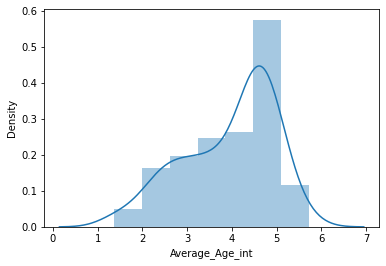

In [16]:
# Plot the distribution of average age integers to gauge frequency of building ages
sns.distplot(joined_df_postal_age['Average_Age_int'])

In [17]:
# Reversing our first mapping to get back the age range 
class_name_reverse_mapping = {
    0: 'Pre-1901',
    1: '1901-1915',
    2: '1916-1930',
    3: '1931-1945',
    4: '1946-1960',
    5: '1961-1975',
    6: '1976-2003'
}

In [18]:
# Re-assigning the 'Average_Age' column to have age groups using the dictionary class_name_reverse_mapping
joined_df_postal_age['Average_Age'] = joined_df_postal_age['Average_Age'].map(class_name_reverse_mapping)
joined_df_postal_age.head() # Final DF

,area_code,Average_Age_int,Average_Age
0,M1B,4.862948,1961-1975
1,M1C,4.839976,1961-1975
2,M1E,4.616922,1961-1975
3,M1G,4.583526,1961-1975
4,M1H,4.761931,1961-1975


In [19]:
# Check unique values produced
joined_df_postal_age['Average_Age'].unique()

array(['1961-1975', '1946-1960', '1976-2003', '1916-1930', '1931-1945',
       '1901-1915'], dtype=object)

## 4. Socioeconomic Data

### Importing Neighbourhood Socioeconomic Data

In [20]:
# Import socioeconomic data as DataFrame and reformat for readability
neighbourhood_se = pd.read_csv('neighbourhood_profiles_2021.csv')
neighbourhood_se.index = neighbourhood_se['Neighbourhood Name']
neighbourhood_se = neighbourhood_se.drop(['Neighbourhood Name'], axis=1)
neighbourhood_se = neighbourhood_se.transpose()
neighbourhood_se.head()

Neighbourhood Name,Neighbourhood Number,TSNS 2020 Designation,Total - Age groups of the population - 25% sample data,0 to 14 years,0 to 4 years,5 to 9 years,10 to 14 years,15 to 64 years,15 to 19 years,20 to 24 years,...,Between 9 a.m. and 11:59 a.m.,Between 12 p.m. and 4:59 a.m.,Total - Eligibility for instruction in the minority official language for the population in private households born in 2003 or later - 25% sample data,Children eligible for instruction in the minority official language,Children not eligible for instruction in the minority official language,"Total - Eligibility and instruction in the minority official language, for the population in private households born between 2003 and 2015 (inclusive) - 25% sample data",Children eligible for instruction in the minority official language,Eligible children who have been instructed in the minority official language at the primary or secondary level in Canada,Eligible children who have not been instructed in the minority official language at the primary or secondary level in Canada,Children not eligible for instruction in the minority official language
West Humber-Clairville,1,Not an NIA or Emerging Neighbourhood,33300,4295,1460,1345,1485,23640,1860,3175,...,1665,2935,5430,410,5020,3875,335,255,75,3540
Mount Olive-Silverstone-Jamestown,2,Neighbourhood Improvement Area,31345,5690,1650,1860,2175,21490,2280,2675,...,1145,2965,7285,510,6780,5540,395,245,145,5145
Thistletown-Beaumond Heights,3,Neighbourhood Improvement Area,9850,1495,505,540,455,6615,570,745,...,395,635,1860,180,1685,1325,120,75,45,1205
Rexdale-Kipling,4,Not an NIA or Emerging Neighbourhood,10375,1575,505,615,455,6950,515,715,...,425,775,1910,135,1770,1370,90,75,25,1275
Elms-Old Rexdale,5,Neighbourhood Improvement Area,9355,1610,440,480,685,6355,635,685,...,355,675,2015,95,1920,1520,70,60,10,1445


In [21]:
# Keep only average household income for now (can be expanded to include more variables)
neighbourhood_income = neighbourhood_se[['Neighbourhood Number', '  Average total income of household in 2020 ($)']]
neighbourhood_income.columns = ['Neighbourhood number', 'Average household income']
neighbourhood_income.index.rename(name='Neighbourhood name', inplace=True)
neighbourhood_income.head()

,Neighbourhood number,Average household income
Neighbourhood name,,
West Humber-Clairville,1,104500
Mount Olive-Silverstone-Jamestown,2,86200
Thistletown-Beaumond Heights,3,101300
Rexdale-Kipling,4,90000
Elms-Old Rexdale,5,94600


### Importing Neighbourhood GeoData

In [22]:
# Import and reformat City of Toronto neighbourhoods boundaries
neighbourhood_boundaries = gpd.read_file('Neighbourhoods - 4326.shp')
neighbourhood_boundaries = neighbourhood_boundaries.to_crs(epsg=2957)
neighbourhood_boundaries = neighbourhood_boundaries[['AREA_NA7','geometry']]
neighbourhood_boundaries.columns = ['Neighbourhood name','geometry']
neighbourhood_boundaries.index = neighbourhood_boundaries['Neighbourhood name']
neighbourhood_boundaries = neighbourhood_boundaries.drop(['Neighbourhood name'], axis=1)
neighbourhood_boundaries.head()

,geometry
Neighbourhood name,
South Eglinton-Davisville,"POLYGON ((2565070.599 5168519.622, 2565092.460..."
North Toronto,"POLYGON ((2563843.300 5169233.848, 2563775.703..."
Dovercourt Village,"POLYGON ((2562606.657 5163062.843, 2562515.282..."
Junction-Wallace Emerson,"POLYGON ((2561961.324 5163775.072, 2562010.447..."
Yonge-Bay Corridor,"POLYGON ((2567200.520 5162712.468, 2567128.346..."


In [23]:
# Merge neighbourhood boundaries and household income
neighbourhood_data = pd.merge(neighbourhood_income, neighbourhood_boundaries, left_index=True, right_index=True)
neighbourhood_data = gpd.GeoDataFrame(neighbourhood_data)
neighbourhood_data.head()

,Neighbourhood number,Average household income,geometry
Neighbourhood name,,,
West Humber-Clairville,1,104500,"POLYGON ((2547319.617 5167116.279, 2547468.432..."
Mount Olive-Silverstone-Jamestown,2,86200,"POLYGON ((2547174.743 5170537.726, 2547185.808..."
Thistletown-Beaumond Heights,3,101300,"POLYGON ((2549227.257 5168938.985, 2549225.274..."
Rexdale-Kipling,4,90000,"POLYGON ((2550220.195 5165397.414, 2550038.827..."
Elms-Old Rexdale,5,94600,"POLYGON ((2550918.577 5167997.989, 2550958.572..."


### Merging Socioeconomic

In [24]:
# Merging the cleaned age dataframe with the postal code data on the geometery
joined_df_postal_SE = gpd.sjoin(neighbourhood_data, filt_df_postal_2957, how="left", predicate="intersects")
joined_df_postal_SE.head()

,Neighbourhood number,Average household income,geometry,index_right,POSTALCODE
Neighbourhood name,,,,,
West Humber-Clairville,1,104500,"POLYGON ((2547319.617 5167116.279, 2547468.432...",51565,M9W6Z9
West Humber-Clairville,1,104500,"POLYGON ((2547319.617 5167116.279, 2547468.432...",51246,M9W5E4
West Humber-Clairville,1,104500,"POLYGON ((2547319.617 5167116.279, 2547468.432...",51566,M9W7A1
West Humber-Clairville,1,104500,"POLYGON ((2547319.617 5167116.279, 2547468.432...",51247,M9W5E5
West Humber-Clairville,1,104500,"POLYGON ((2547319.617 5167116.279, 2547468.432...",51248,M9W5E6


In [25]:
joined_df_postal_SE = gpd.sjoin(neighbourhood_data, area_code_boundaries, how="left", predicate="intersects")
joined_df_postal_SE.head()

,Neighbourhood number,Average household income,geometry,index_right,area_code
Neighbourhood name,,,,,
West Humber-Clairville,1,104500,"POLYGON ((2547319.617 5167116.279, 2547468.432...",99,M9W
West Humber-Clairville,1,104500,"POLYGON ((2547319.617 5167116.279, 2547468.432...",98,M9V
Mount Olive-Silverstone-Jamestown,2,86200,"POLYGON ((2547174.743 5170537.726, 2547185.808...",98,M9V
Thistletown-Beaumond Heights,3,101300,"POLYGON ((2549227.257 5168938.985, 2549225.274...",98,M9V
Thistletown-Beaumond Heights,3,101300,"POLYGON ((2549227.257 5168938.985, 2549225.274...",94,M9M


### Getting weighted average socioeconomic data for each area code
Weighted by overlap area between neighbourhoods and area codes

In [26]:
# Calculate overlaps between neighbourhood and area code GeoData
_overlay = gpd.overlay(neighbourhood_data, area_code_boundaries, how="intersection")

In [27]:
# Add overlay areas as a new column
_overlay['area'] = _overlay.geometry.area

/Users/steffanylung/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='area', ylabel='Density'>

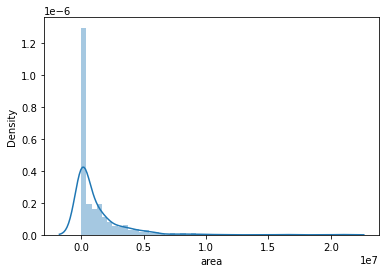

In [28]:
# Plot distribution of overlay areas - observe high number of low areas indicating small overlaps in boundaries
sns.distplot(_overlay['area'])

<AxesSubplot:>

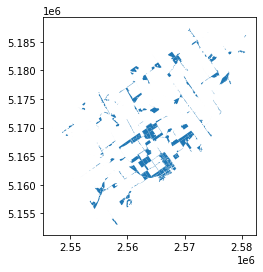

In [29]:
# Map overlays under 1e6 in size (peak in distribution) to visualize small boundary overlaps
_overlay[_overlay['area']< 1e6]['geometry'].plot()

In [30]:
# Set household income to int to allow for weighting averages
_overlay['Average household income'] = _overlay['Average household income'].astype(int)

In [31]:
# View overlay info
_overlay.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 513 entries, 0 to 512
Data columns (total 5 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   Neighbourhood number      513 non-null    object  
 1   Average household income  513 non-null    int64   
 2   area_code                 513 non-null    object  
 3   geometry                  513 non-null    geometry
 4   area                      513 non-null    float64 
dtypes: float64(1), geometry(1), int64(1), object(2)
memory usage: 20.2+ KB


In [32]:
# Calculate weighted household income for each area code
area_code_socioeconomics = _overlay.groupby('area_code').apply(lambda group: np.average(group['Average household income'], weights=group['area'])).reset_index(name='Average_Household_Income')
area_code_socioeconomics.head() # View DataFrame

,area_code,Average_Household_Income
0,M1B,115616.248665
1,M1C,140535.461835
2,M1E,99073.469141
3,M1G,91658.256232
4,M1H,87146.443373


## 5. Solar Potential Data

In [34]:
# Read solar potential data to GeoDataFrame and set crs
solar_data = gpd.read_file('solarto-map - 4326.shp', SHAPE_RESTORE_SHX = 'YES')
solar_data_2957 = solar_data.to_crs(epsg=2957)
solar_data_2957.head()

,_id1,objecti2,structu3,roofsiz4,rooftop5,roof_si6,annual_7,system_8,system_9,first_y10,f_25_ye11,payback12,annual_13,total_g14,trees_g15,cars_of16,geometry
0,1,1,38 Westleigh Cres - Structure 1,117.0,1259.0,44.0,5627,4.893043,14700,881,39262,10.0,394,9847,164,2,"POLYGON ((2555348.668 5152952.976, 2555340.241..."
1,2,2,36 Westleigh Cres - Structure 1,101.0,1087.0,51.0,6012,5.227826,14100,941,41936,9.0,421,10521,175,2,"POLYGON ((2555329.515 5152962.112, 2555325.746..."
2,3,3,34 Westleigh Cres - Structure 1,74.0,797.0,32.0,4061,3.531304,10600,636,28343,10.0,284,7107,118,2,"POLYGON ((2555333.993 5152991.670, 2555342.687..."
3,4,4,34 Westleigh Cres - Structure 2,42.0,452.0,12.0,1480,1.286957,3900,232,10339,10.0,104,2590,43,1,"POLYGON ((2555332.030 5152976.610, 2555330.020..."
4,5,5,40 Westleigh Cres - Structure 1,79.0,850.0,14.0,1775,1.543478,4600,278,12389,10.0,124,3106,52,1,"POLYGON ((2555355.296 5152950.505, 2555364.931..."


In [35]:
# Define old to new column names
column_selection = {
    'structu3': 'Street',
    'roofsiz4': 'Roof_size',
    'annual_7': 'Annual_electricity_generation_k',
    'system_8': 'System_size',
    'system_9': 'System_cost',
    'first_y10': '1_year_bill_savings',
    'f_25_ye11': '25_year_bill_savings',
    'payback12': 'Payback_period',
    'annual_13': 'Annual_ghg_reduction_kg',
    'geometry': 'Geometry'
}

# Select and rename columns in one step, creating the final DataFrame
solar_final = solar_data_2957.rename(columns=column_selection)[list(column_selection.values())]

# Display the first few rows of the subsetted data to verify
solar_final.head()

,Street,Roof_size,Annual_electricity_generation_k,System_size,System_cost,1_year_bill_savings,25_year_bill_savings,Payback_period,Annual_ghg_reduction_kg,Geometry
0,38 Westleigh Cres - Structure 1,117.0,5627,4.893043,14700,881,39262,10.0,394,"POLYGON ((2555348.668 5152952.976, 2555340.241..."
1,36 Westleigh Cres - Structure 1,101.0,6012,5.227826,14100,941,41936,9.0,421,"POLYGON ((2555329.515 5152962.112, 2555325.746..."
2,34 Westleigh Cres - Structure 1,74.0,4061,3.531304,10600,636,28343,10.0,284,"POLYGON ((2555333.993 5152991.670, 2555342.687..."
3,34 Westleigh Cres - Structure 2,42.0,1480,1.286957,3900,232,10339,10.0,104,"POLYGON ((2555332.030 5152976.610, 2555330.020..."
4,40 Westleigh Cres - Structure 1,79.0,1775,1.543478,4600,278,12389,10.0,124,"POLYGON ((2555355.296 5152950.505, 2555364.931..."


In [36]:
# Check missing data
print('Missingness before modification:')
print(solar_final.isnull().sum())

Missingness before modification:
Street                             0
Roof_size                          0
Annual_electricity_generation_k    0
System_size                        0
System_cost                        0
1_year_bill_savings                0
25_year_bill_savings               0
Payback_period                     0
Annual_ghg_reduction_kg            0
Geometry                           0
dtype: int64


#### Solar potential specific postal code readfile - or else loose resolution (keeping 6 - letters)

In [37]:
# Start with postal code dataframe from earlier
df_postal_gpd.head()

,PCA_ID,POSTALCODE,PROV,MAF_ID,PREC_CODE,PCA_COUNT,DOM_PCA,MULTI_PC,DEL_M_ID,LONGITUDE,LATITUDE,geometry
0,180000001,L4S1M4,ON,350005325,2,2,0,0,SS0315,-79.415566,43.894633,"POLYGON ((-79.41532 43.89477, -79.41524 43.894..."
1,180000002,K1Y3R6,ON,350002120,2,1,1,0,LC0011,-75.721267,45.398581,"POLYGON ((-75.72044 45.39871, -75.72055 45.398..."
2,180000003,L4S1M5,ON,350005325,2,1,1,0,SS0315,-79.401105,43.900182,"POLYGON ((-79.39646 43.90124, -79.39635 43.900..."
3,180000004,L4S1M6,ON,350005325,2,1,1,0,None,-79.389156,43.901523,"POLYGON ((-79.38926 43.90014, -79.38956 43.900..."
4,180000005,L4S1M7,ON,350005325,2,3,0,0,SS0315,-79.415879,43.892396,"POLYGON ((-79.41526 43.89340, -79.41523 43.893..."


In [38]:
postal_data_2957 = df_postal_gpd.to_crs(epsg=2957) # Convert crs
postal_data_2957.head() # View first few rows

,PCA_ID,POSTALCODE,PROV,MAF_ID,PREC_CODE,PCA_COUNT,DOM_PCA,MULTI_PC,DEL_M_ID,LONGITUDE,LATITUDE,geometry
0,180000001,L4S1M4,ON,350005325,2,2,0,0,SS0315,-79.415566,43.894633,"POLYGON ((2555492.847 5189600.571, 2555498.935..."
1,180000002,K1Y3R6,ON,350002120,2,1,1,0,LC0011,-75.721267,45.398581,"POLYGON ((2786162.707 5462032.505, 2786157.722..."
2,180000003,L4S1M5,ON,350005325,2,1,1,0,SS0315,-79.401105,43.900182,"POLYGON ((2556767.252 5190821.386, 2556791.926..."
3,180000004,L4S1M6,ON,350005325,2,1,1,0,None,-79.389156,43.901523,"POLYGON ((2557385.063 5190891.433, 2557344.269..."
4,180000005,L4S1M7,ON,350005325,2,3,0,0,SS0315,-79.415879,43.892396,"POLYGON ((2555548.700 5189450.056, 2555553.669..."


In [39]:
# Define old to new column names
postal_data_2957 = postal_data_2957[['POSTALCODE', 'geometry']].rename(columns={
    'POSTALCODE': 'Postal_code',
    'geometry': 'Geometry'
})

postal_data_2957.head()

,Postal_code,Geometry
0,L4S1M4,"POLYGON ((2555492.847 5189600.571, 2555498.935..."
1,K1Y3R6,"POLYGON ((2786162.707 5462032.505, 2786157.722..."
2,L4S1M5,"POLYGON ((2556767.252 5190821.386, 2556791.926..."
3,L4S1M6,"POLYGON ((2557385.063 5190891.433, 2557344.269..."
4,L4S1M7,"POLYGON ((2555548.700 5189450.056, 2555553.669..."


In [40]:
# Assuming 'Geometry' is the geometry column in postal_data_2957
postal_data_2957 = postal_data_2957.set_geometry('Geometry')
solar_final = solar_final.set_geometry('Geometry')

# Perform spatial join using the 'within' operation
joined_solar = gpd.sjoin(solar_final, postal_data_2957, how='left', predicate='within')
joined_solar.head()

,Street,Roof_size,Annual_electricity_generation_k,System_size,System_cost,1_year_bill_savings,25_year_bill_savings,Payback_period,Annual_ghg_reduction_kg,Geometry,index_right,Postal_code
0,38 Westleigh Cres - Structure 1,117.0,5627,4.893043,14700,881,39262,10.0,394,"POLYGON ((2555348.668 5152952.976, 2555340.241...",369319.0,M8W3Z7
1,36 Westleigh Cres - Structure 1,101.0,6012,5.227826,14100,941,41936,9.0,421,"POLYGON ((2555329.515 5152962.112, 2555325.746...",369319.0,M8W3Z7
2,34 Westleigh Cres - Structure 1,74.0,4061,3.531304,10600,636,28343,10.0,284,"POLYGON ((2555333.993 5152991.670, 2555342.687...",369319.0,M8W3Z7
3,34 Westleigh Cres - Structure 2,42.0,1480,1.286957,3900,232,10339,10.0,104,"POLYGON ((2555332.030 5152976.610, 2555330.020...",369319.0,M8W3Z7
4,40 Westleigh Cres - Structure 1,79.0,1775,1.543478,4600,278,12389,10.0,124,"POLYGON ((2555355.296 5152950.505, 2555364.931...",369319.0,M8W3Z7


In [41]:
# Assuming 'Geometry' is the geometry column in postal_data_2957
solar_final = solar_final.set_geometry('Geometry')

# Perform spatial join using the 'within' operation
joined_solar = gpd.sjoin(solar_final, postal_data_2957, how='left', op='within')
joined_solar.head()

/Users/steffanylung/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3338: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if (await self.run_code(code, result,  async_=asy)):


,Street,Roof_size,Annual_electricity_generation_k,System_size,System_cost,1_year_bill_savings,25_year_bill_savings,Payback_period,Annual_ghg_reduction_kg,Geometry,index_right,Postal_code
0,38 Westleigh Cres - Structure 1,117.0,5627,4.893043,14700,881,39262,10.0,394,"POLYGON ((2555348.668 5152952.976, 2555340.241...",369319.0,M8W3Z7
1,36 Westleigh Cres - Structure 1,101.0,6012,5.227826,14100,941,41936,9.0,421,"POLYGON ((2555329.515 5152962.112, 2555325.746...",369319.0,M8W3Z7
2,34 Westleigh Cres - Structure 1,74.0,4061,3.531304,10600,636,28343,10.0,284,"POLYGON ((2555333.993 5152991.670, 2555342.687...",369319.0,M8W3Z7
3,34 Westleigh Cres - Structure 2,42.0,1480,1.286957,3900,232,10339,10.0,104,"POLYGON ((2555332.030 5152976.610, 2555330.020...",369319.0,M8W3Z7
4,40 Westleigh Cres - Structure 1,79.0,1775,1.543478,4600,278,12389,10.0,124,"POLYGON ((2555355.296 5152950.505, 2555364.931...",369319.0,M8W3Z7


In [42]:
# Reorder the columns
columns = list(joined_solar.columns)
columns.insert(columns.index('Roof_size'), columns.pop(columns.index('Postal_code')))
joined_solar = joined_solar[columns]

# Remove the 'index_right' column
joined_solar_final = joined_solar.drop('index_right', axis=1)
joined_solar_final.head()

,Street,Postal_code,Roof_size,Annual_electricity_generation_k,System_size,System_cost,1_year_bill_savings,25_year_bill_savings,Payback_period,Annual_ghg_reduction_kg,Geometry
0,38 Westleigh Cres - Structure 1,M8W3Z7,117.0,5627,4.893043,14700,881,39262,10.0,394,"POLYGON ((2555348.668 5152952.976, 2555340.241..."
1,36 Westleigh Cres - Structure 1,M8W3Z7,101.0,6012,5.227826,14100,941,41936,9.0,421,"POLYGON ((2555329.515 5152962.112, 2555325.746..."
2,34 Westleigh Cres - Structure 1,M8W3Z7,74.0,4061,3.531304,10600,636,28343,10.0,284,"POLYGON ((2555333.993 5152991.670, 2555342.687..."
3,34 Westleigh Cres - Structure 2,M8W3Z7,42.0,1480,1.286957,3900,232,10339,10.0,104,"POLYGON ((2555332.030 5152976.610, 2555330.020..."
4,40 Westleigh Cres - Structure 1,M8W3Z7,79.0,1775,1.543478,4600,278,12389,10.0,124,"POLYGON ((2555355.296 5152950.505, 2555364.931..."


In [43]:
# Filter columns
filtered = joined_solar_final[['Postal_code', 'Annual_electricity_generation_k', 'Annual_ghg_reduction_kg', 'Geometry']]

# Aggregate by Postal_code and Geometry and sum up the values
aggregated = filtered.groupby(['Postal_code', 'Geometry']).sum().reset_index()
aggregated.head()

,Postal_code,Geometry,Annual_electricity_generation_k,Annual_ghg_reduction_kg
0,L4L1V8,"POLYGON ((2547364.118244635 5170869.481464398,...",22582,1581
1,L4L1V8,POLYGON ((2547392.7681222083 5170882.053645139...,31322,2193
2,L4L1V8,"POLYGON ((2547376.061323055 5170907.604006861,...",23301,1631
3,L5M0T5,POLYGON ((2550000.5945524373 5159323.085215423...,142976,10008
4,L5M0T5,POLYGON ((2550025.9533273512 5159392.196035841...,58184,4073


In [44]:
# Group by Postal_code and Geometry, summing up the other columns
grouped = joined_solar_final.groupby(['Postal_code', 'Geometry']).agg({
    'Annual_electricity_generation_k': 'sum',
    'Annual_ghg_reduction_kg': 'sum'
}).reset_index()

# Then, group only by Postal_code, summing the grouped values
merged = grouped.groupby('Postal_code').agg({
    'Annual_electricity_generation_k': 'sum',
    'Annual_ghg_reduction_kg': 'sum'
}).reset_index()
merged.head() 

,Postal_code,Annual_electricity_generation_k,Annual_ghg_reduction_kg
0,L4L1V8,77205,5405
1,L5M0T5,201160,14081
2,M1B0A2,1826520,127856
3,M1B0A3,239890,16790
4,M1B0A4,8725,611


In [45]:
# Print unique postal codes
unique_postal = merged['Postal_code'].unique()
print(unique_postal)

# Print number of unique postal codes
total_unique_count = len(unique_postal)
print("Total unique Postal_code values:", total_unique_count)

['L4L1V8' 'L5M0T5' 'M1B0A2' ... 'M9W7K3' 'M9W7K4' 'M9W7K7']
Total unique Postal_code values: 41045


In [46]:
# Extract the first three letters of the Postal_code column
merged['area_code'] = merged['Postal_code'].str[:3]

# Group by the abbreviated Postal_code and sum the other columns
grouped_abbreviated = merged.groupby('area_code').agg({
    'Annual_electricity_generation_k': 'sum',
    'Annual_ghg_reduction_kg': 'sum'
}).reset_index()

grouped_abbreviated.head() # Final DataFrame

,area_code,Annual_electricity_generation_k,Annual_ghg_reduction_kg
0,L4L,77205,5405
1,L5M,201160,14081
2,M1B,200431782,14030251
3,M1C,129826652,9087895
4,M1E,131712672,9219883


In [47]:
# Print unique area codes
unique_codes = grouped_abbreviated['area_code'].unique()
print(unique_codes)

# Print number of unieque area codes
total_unique_count = len(unique_codes)
print("Total unique Postal_code values:", total_unique_count)

['L4L' 'L5M' 'M1B' 'M1C' 'M1E' 'M1G' 'M1H' 'M1J' 'M1K' 'M1L' 'M1M' 'M1N'
 'M1P' 'M1R' 'M1S' 'M1T' 'M1V' 'M1W' 'M1X' 'M2H' 'M2J' 'M2K' 'M2L' 'M2M'
 'M2N' 'M2P' 'M2R' 'M3A' 'M3B' 'M3C' 'M3H' 'M3J' 'M3K' 'M3L' 'M3M' 'M3N'
 'M4A' 'M4B' 'M4C' 'M4E' 'M4G' 'M4H' 'M4J' 'M4K' 'M4L' 'M4M' 'M4N' 'M4P'
 'M4R' 'M4S' 'M4T' 'M4V' 'M4W' 'M4X' 'M4Y' 'M5A' 'M5B' 'M5C' 'M5E' 'M5G'
 'M5H' 'M5J' 'M5K' 'M5L' 'M5M' 'M5N' 'M5P' 'M5R' 'M5S' 'M5T' 'M5V' 'M6A'
 'M6B' 'M6C' 'M6E' 'M6G' 'M6H' 'M6J' 'M6K' 'M6L' 'M6M' 'M6N' 'M6P' 'M6R'
 'M6S' 'M7A' 'M8V' 'M8W' 'M8X' 'M8Y' 'M8Z' 'M9A' 'M9B' 'M9C' 'M9L' 'M9M'
 'M9N' 'M9P' 'M9R' 'M9V' 'M9W']
Total unique Postal_code values: 101


# C. Combining Datasets

### View the datasets to merge

In [48]:
# Building energy data
building_energy_filt['Postal_Code'] = building_energy_filt['Postal_Code'].str.upper()
building_energy_filt.head()

,City,Postal_Code,PrimPropTypCalc,WN_Sit_Elc_Int1,WN_Sit_Gas_Int1,GHG_Emiss_Int1,Ener_Star_Score
0,Toronto,M1N,Multifamily Housing,0.368126,0.113538,9.687520,74
1,Scarborough,M1L,Multifamily Housing,0.406876,0.340613,18.298649,39
2,Toronto,M1L,Multifamily Housing,0.259626,0.681226,33.368124,46
3,Toronto,M1L,Multifamily Housing,0.387501,0.340613,17.222258,53
4,Toronto,M1L,Multifamily Housing,0.383626,0.340613,19.375040,23


In [49]:
# Building age data
joined_df_postal_age.head()

,area_code,Average_Age_int,Average_Age
0,M1B,4.862948,1961-1975
1,M1C,4.839976,1961-1975
2,M1E,4.616922,1961-1975
3,M1G,4.583526,1961-1975
4,M1H,4.761931,1961-1975


In [50]:
# Socioeconomic data
area_code_socioeconomics.head()

,area_code,Average_Household_Income
0,M1B,115616.248665
1,M1C,140535.461835
2,M1E,99073.469141
3,M1G,91658.256232
4,M1H,87146.443373


In [51]:
# Solar potential data
grouped_abbreviated.head()

,area_code,Annual_electricity_generation_k,Annual_ghg_reduction_kg
0,L4L,77205,5405
1,L5M,201160,14081
2,M1B,200431782,14030251
3,M1C,129826652,9087895
4,M1E,131712672,9219883


### Merge the datasets

In [52]:
# Merge all four datasets, keeping area codes from each in the case of data gaps
all_datasets = building_energy_filt.merge(joined_df_postal_age, how= 'left', left_on='Postal_Code', right_on= 'area_code')
all_datasets = all_datasets.merge(area_code_socioeconomics, how= 'left', left_on='Postal_Code', right_on= 'area_code')
all_datasets = all_datasets.merge(grouped_abbreviated, how= 'left', left_on='Postal_Code', right_on= 'area_code')
all_datasets.head() # View first few entries

,City,Postal_Code,PrimPropTypCalc,WN_Sit_Elc_Int1,WN_Sit_Gas_Int1,GHG_Emiss_Int1,Ener_Star_Score,area_code_x,Average_Age_int,Average_Age,area_code_y,Average_Household_Income,area_code,Annual_electricity_generation_k,Annual_ghg_reduction_kg
0,Toronto,M1N,Multifamily Housing,0.368126,0.113538,9.687520,74,M1N,3.965507,1946-1960,M1N,131075.252417,M1N,51147495.0,3580401.0
1,Scarborough,M1L,Multifamily Housing,0.406876,0.340613,18.298649,39,M1L,4.521639,1961-1975,M1L,97329.028602,M1L,101061619.0,7074310.0
2,Toronto,M1L,Multifamily Housing,0.259626,0.681226,33.368124,46,M1L,4.521639,1961-1975,M1L,97329.028602,M1L,101061619.0,7074310.0
3,Toronto,M1L,Multifamily Housing,0.387501,0.340613,17.222258,53,M1L,4.521639,1961-1975,M1L,97329.028602,M1L,101061619.0,7074310.0
4,Toronto,M1L,Multifamily Housing,0.383626,0.340613,19.375040,23,M1L,4.521639,1961-1975,M1L,97329.028602,M1L,101061619.0,7074310.0


In [53]:
# View combined dataset info
all_datasets.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1411 entries, 0 to 1410
Data columns (total 15 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   City                             1411 non-null   object 
 1   Postal_Code                      1411 non-null   object 
 2   PrimPropTypCalc                  1411 non-null   object 
 3   WN_Sit_Elc_Int1                  1411 non-null   object 
 4   WN_Sit_Gas_Int1                  1411 non-null   object 
 5   GHG_Emiss_Int1                   1411 non-null   float64
 6   Ener_Star_Score                  1411 non-null   object 
 7   area_code_x                      1409 non-null   object 
 8   Average_Age_int                  1409 non-null   float64
 9   Average_Age                      1409 non-null   object 
 10  area_code_y                      1411 non-null   object 
 11  Average_Household_Income         1411 non-null   float64
 12  area_code           

In [54]:
# Looking into null values
all_datasets[all_datasets['Postal_Code']=='M5L']

,City,Postal_Code,PrimPropTypCalc,WN_Sit_Elc_Int1,WN_Sit_Gas_Int1,GHG_Emiss_Int1,Ener_Star_Score,area_code_x,Average_Age_int,Average_Age,area_code_y,Average_Household_Income,area_code,Annual_electricity_generation_k,Annual_ghg_reduction_kg
295,Toronto,M5L,Office,0.503751,0,26.909778,67,NaN,NaN,NaN,M5L,99800.0,M5L,124975.0,8748.0


In [55]:
all_datasets[all_datasets['area_code'].isna()]

,City,Postal_Code,PrimPropTypCalc,WN_Sit_Elc_Int1,WN_Sit_Gas_Int1,GHG_Emiss_Int1,Ener_Star_Score,area_code_x,Average_Age_int,Average_Age,area_code_y,Average_Household_Income,area_code,Annual_electricity_generation_k,Annual_ghg_reduction_kg
341,Toronto,M5X,Office,0.523126,0.227075,0.0,94,NaN,NaN,NaN,M5X,99800.0,NaN,NaN,NaN


In [56]:
# Write combined data to csv
all_datasets.to_csv('all_datasets.csv')

## D. Interactive maps

In [57]:
# Create a geometries dataframe for mapping
map_geometries = area_code_boundaries.set_index('area_code')
map_geometries = map_geometries.to_crs(epsg=4326)
map_geometries.index.names = ['Postal_Code']
map_geometries.head()

,geometry
Postal_Code,
M1B,"MULTIPOLYGON (((-79.23828 43.79276, -79.23855 ..."
M1C,"MULTIPOLYGON (((-79.19315 43.78489, -79.19312 ..."
M1E,"MULTIPOLYGON (((-79.49177 43.66861, -79.49159 ..."
M1G,"MULTIPOLYGON (((-79.22983 43.77145, -79.22996 ..."
M1H,"MULTIPOLYGON (((-79.24976 43.76749, -79.25001 ..."


In [58]:
# View combined dataframe
all_datasets.head()

,City,Postal_Code,PrimPropTypCalc,WN_Sit_Elc_Int1,WN_Sit_Gas_Int1,GHG_Emiss_Int1,Ener_Star_Score,area_code_x,Average_Age_int,Average_Age,area_code_y,Average_Household_Income,area_code,Annual_electricity_generation_k,Annual_ghg_reduction_kg
0,Toronto,M1N,Multifamily Housing,0.368126,0.113538,9.687520,74,M1N,3.965507,1946-1960,M1N,131075.252417,M1N,51147495.0,3580401.0
1,Scarborough,M1L,Multifamily Housing,0.406876,0.340613,18.298649,39,M1L,4.521639,1961-1975,M1L,97329.028602,M1L,101061619.0,7074310.0
2,Toronto,M1L,Multifamily Housing,0.259626,0.681226,33.368124,46,M1L,4.521639,1961-1975,M1L,97329.028602,M1L,101061619.0,7074310.0
3,Toronto,M1L,Multifamily Housing,0.387501,0.340613,17.222258,53,M1L,4.521639,1961-1975,M1L,97329.028602,M1L,101061619.0,7074310.0
4,Toronto,M1L,Multifamily Housing,0.383626,0.340613,19.375040,23,M1L,4.521639,1961-1975,M1L,97329.028602,M1L,101061619.0,7074310.0


In [59]:
# Create map for ener star scores
ener_star_scores = all_datasets[['Postal_Code','Ener_Star_Score']].dropna()
ener_star_scores = ener_star_scores[ener_star_scores['Ener_Star_Score'] != 'Not Available']
ener_star_scores['Ener_Star_Score'].unique() # View unique values to check all numerical

# Create a base map
map_1 = folium.Map(location=[43.7326, -79.3871], 
                 tiles='openstreetmap',                 
                   zoom_start=11)

# Add a choropleth map to the base map
Choropleth(geo_data=map_geometries.__geo_interface__, # use 'plot_geography' for geographic data
            columns=['Postal_Code', 'Ener_Star_Score'],           
            data=ener_star_scores,                           # use 'plot_data' ('station_density') to color the regions
            key_on='feature.id', 
            fill_color='YlOrRd', 
            legend_name='Ener Star Score'
            ).add_to(map_1)

# Display the map
map_1

In [60]:
# Create map for average age

# Create a base map
map_2 = folium.Map(location=[43.7326, -79.3871], 
                 tiles='openstreetmap',                 
                   zoom_start=11)

# Add a choropleth map to the base map
Choropleth(geo_data=map_geometries.__geo_interface__, # use 'plot_geography' for geographic data
            columns=['Postal_Code', 'Average_Age_int'],           
            data=all_datasets,                           # use 'plot_data' ('station_density') to color the regions
            key_on='feature.id', 
            fill_color='YlOrRd', 
            legend_name='Ener Star Score'
            ).add_to(map_2)

# Display the map
map_2

HERE ONWARDS CAN BE REPLACED WITH COPYING AND PASTING THE CODE BLOCK ABOVE FOR DIFFERENT VARIABLES

In [65]:
test3 = all_datasets[all_datasets['GHG_Emiss_Int1'] < 1000]
test3 = all_datasets[all_datasets['GHG_Emiss_Int1'] > 0]

print(test3['GHG_Emiss_Int1'].sort_values())

1120    1.076391e+00
1066    1.076391e+00
1379    2.152782e+00
55      2.152782e+00
89      2.152782e+00
            ...     
658     2.970839e+02
1367    6.070846e+02
657     6.716681e+02
411     1.587332e+05
680     1.298720e+06
Name: GHG_Emiss_Int1, Length: 1357, dtype: float64


In [66]:
# test.index = test['three_letter_pc']
# test = test.drop(['Unnamed: 0', 'three_letter_pc'], axis=1)

In [67]:
test3.columns

Index(['City', 'Postal_Code', 'PrimPropTypCalc', 'WN_Sit_Elc_Int1',
       'WN_Sit_Gas_Int1', 'GHG_Emiss_Int1', 'Ener_Star_Score', 'area_code_x',
       'Average_Age_int', 'Average_Age', 'area_code_y',
       'Average_Household_Income', 'area_code',
       'Annual_electricity_generation_k', 'Annual_ghg_reduction_kg'],
      dtype='object')

In [68]:
test3 = test3[test3['WN_Sit_Gas_Int1'] != 'Not Available']

In [70]:
# Create a base map
map_7 = folium.Map(location=[43.6426, -79.3871], 
                 tiles='cartodbpositron',                 
                   zoom_start=10)

# Add a choropleth map to the base map
Choropleth(geo_data=test.__geo_interface__, # use 'plot_geography' for geographic data
            columns=['Postal_Code', 'Average_Age_int'],           
            data=test3,                           # use 'plot_data' ('station_density') to color the regions
            key_on='feature.id', 
            fill_color='GnBu', 
            legend_name='Average Age'
            ).add_to(map_6)

# Display the map
map_6

AttributeError: 'DataFrame' object has no attribute '__geo_interface__'

C:\Users\chait\AppData\Local\Temp\ipykernel_11448\1093876146.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(test5['WN_Sit_Elc_Int1'])


<Axes: xlabel='WN_Sit_Elc_Int1', ylabel='Density'>

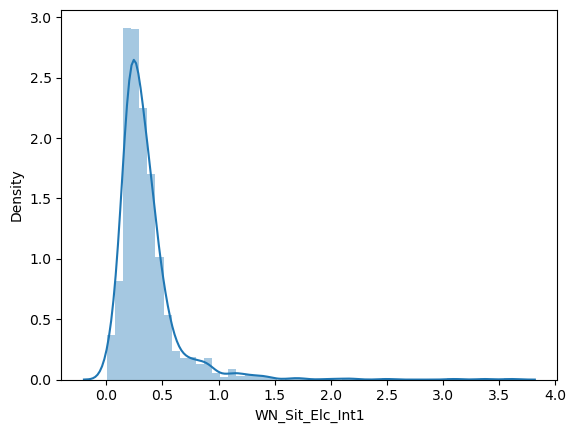

In [177]:
sns.distplot(test5['WN_Sit_Elc_Int1'])

In [174]:
test5 = test3[test3['WN_Sit_Elc_Int1'] < 4]

In [230]:
# Create a base map
map_8 = folium.Map(location=[43.6426, -79.3871], 
                 tiles='openstreetmap',                 
                   zoom_start=11)

# Add a choropleth map to the base map
Choropleth(geo_data=test.__geo_interface__, # use 'plot_geography' for geographic data
            columns=['Postal_Code', 'Average_Household_Income'],           
            data=test5,                           # use 'plot_data' ('station_density') to color the regions
            key_on='feature.id', 
            fill_color='YlOrRd', 
            legend_name='Average_Household_Income'
            ).add_to(map_8)

# Display the map
map_8

In [137]:
all_datasets.head()

,City,Postal_Code,PrimPropTypCalc,WN_Sit_Elc_Int1,WN_Sit_Gas_Int1,GHG_Emiss_Int1,Ener_Star_Score,three_letter_pc_x,Average_Age_int,Average_Age,three_letter_pc_y,Average_Household_Income,Abbreviated_Postal_code,Annual_electricity_generation_k,Annual_ghg_reduction_kg
0,Toronto,M1N,Multifamily Housing,0.368126,0.113538,9.687520,74,M1N,3.965369,1946-1960,M1N,131060.567448,M1N,50928045.0,3565042.0
1,Scarborough,M1L,Multifamily Housing,0.406876,0.340613,18.298649,39,M1L,4.521675,1961-1975,M1L,97332.149125,M1L,99216308.0,6945139.0
2,Toronto,M1L,Multifamily Housing,0.259626,0.681226,33.368124,46,M1L,4.521675,1961-1975,M1L,97332.149125,M1L,99216308.0,6945139.0
3,Toronto,M1L,Multifamily Housing,0.387501,0.340613,17.222258,53,M1L,4.521675,1961-1975,M1L,97332.149125,M1L,99216308.0,6945139.0
4,Toronto,M1L,Multifamily Housing,0.383626,0.340613,19.375040,23,M1L,4.521675,1961-1975,M1L,97332.149125,M1L,99216308.0,6945139.0


In [142]:
all_datasets['Average_Age'].unique()

array(['1946-1960', '1961-1975', '1931-1945', '1976-2003', '1916-1930',
       '1901-1915', nan], dtype=object)

In [154]:
test4 = all_datasets[all_datasets['GHG_Emiss_Int1'] < 800]

C:\Users\chait\AppData\Local\Temp\ipykernel_11448\2125041410.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(test4[test4['Average_Age'] == '1901-1915']['GHG_Emiss_Int1'])
C:\Users\chait\AppData\Local\Temp\ipykernel_11448\2125041410.py:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(test4[te

(0.0, 600.0)

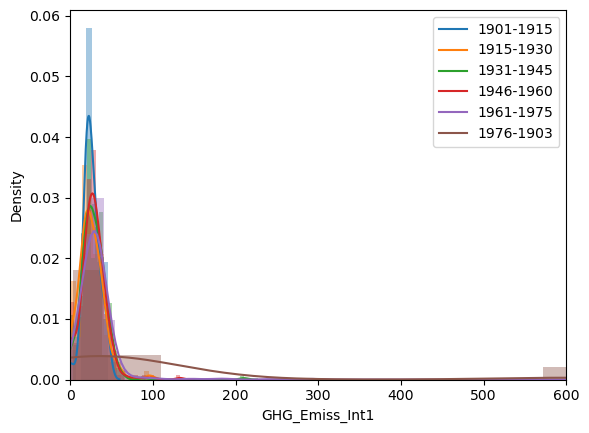

In [163]:
sns.distplot(test4[test4['Average_Age'] == '1901-1915']['GHG_Emiss_Int1'])
sns.distplot(test4[test4['Average_Age'] == '1916-1930']['GHG_Emiss_Int1'])
sns.distplot(test4[test4['Average_Age'] == '1931-1945']['GHG_Emiss_Int1'])
sns.distplot(test4[test4['Average_Age'] == '1946-1960']['GHG_Emiss_Int1'])
sns.distplot(test4[test4['Average_Age'] == '1961-1975']['GHG_Emiss_Int1'])
sns.distplot(test4[test4['Average_Age'] == '1976-2003']['GHG_Emiss_Int1'])
plt.legend(['1901-1915','1915-1930','1931-1945','1946-1960','1961-1975','1976-1903'])
plt.xlim([0, 600])

In [167]:
test4.groupby(['PrimPropTypCalc']).sum()

C:\Users\chait\AppData\Local\Temp\ipykernel_11448\2120007288.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  test4.groupby(['PrimPropTypCalc']).sum()


,GHG_Emiss_Int1,Average_Age_int,Average_Household_Income,Annual_electricity_generation_k,Annual_ghg_reduction_kg
PrimPropTypCalc,,,,,
Bureau,293.854773,44.746796,1.271168e+06,1.382451e+08,9.677148e+06
College/University,61.354293,9.909719,2.149008e+05,1.654324e+08,1.158030e+07
Commerce de détail,65.659858,14.246619,3.065073e+05,4.235160e+08,2.964614e+07
Convention Center,17.222258,2.836221,1.185701e+05,1.972008e+07,1.380398e+06
Distribution Center,342.292373,50.616279,1.394730e+06,2.034461e+09,1.424124e+08
Enclosed Mall,475.764871,70.703630,1.842421e+06,1.352604e+09,9.468253e+07
Entrepôt non réfrigéré,292.778382,9.869738,2.251160e+05,4.955984e+08,3.469192e+07
Entrepôt réfrigéré,40.902862,8.880550,3.146542e+05,1.988994e+08,1.392298e+07
Financial Office,37.673689,4.851260,2.241792e+05,5.892944e+07,4.125077e+06


In [ ]:
'Annual_electricity_generation_k'

In [181]:
test4['PrimPropTypCalc']

0               Multifamily Housing
1               Multifamily Housing
2               Multifamily Housing
3               Multifamily Housing
4               Multifamily Housing
                   ...             
1406                          Other
1407    Other - Lodging/Residential
1408            Multifamily Housing
1409            Multifamily Housing
1410                         Office
Name: PrimPropTypCalc, Length: 1409, dtype: object

C:\Users\chait\AppData\Local\Temp\ipykernel_11448\2075286952.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(test4[test4['PrimPropTypCalc'] == 'Multifamily Housing']['GHG_Emiss_Int1'])
C:\Users\chait\AppData\Local\Temp\ipykernel_11448\2075286952.py:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.dis

(0.0, 700.0)

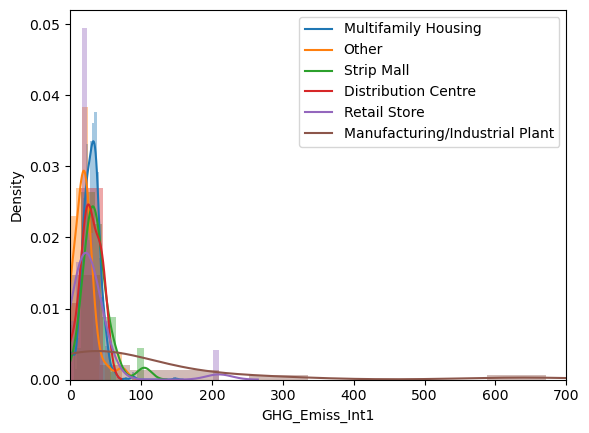

In [222]:
sns.distplot(test4[test4['PrimPropTypCalc'] == 'Multifamily Housing']['GHG_Emiss_Int1'])
sns.distplot(test4[test4['PrimPropTypCalc'] == 'Other']['GHG_Emiss_Int1'])
sns.distplot(test4[test4['PrimPropTypCalc'] == 'Strip Mall']['GHG_Emiss_Int1'])
sns.distplot(test4[test4['PrimPropTypCalc'] == 'Distribution Center']['GHG_Emiss_Int1'])
sns.distplot(test4[test4['PrimPropTypCalc'] == 'Retail Store']['GHG_Emiss_Int1'])
sns.distplot(test4[test4['PrimPropTypCalc'] == 'Manufacturing/Industrial Plant']['GHG_Emiss_Int1'])
plt.legend(['Multifamily Housing', 'Other','Strip Mall','Distribution Centre','Retail Store','Manufacturing/Industrial Plant'])
plt.xlim([0,700])

In [183]:
multifamilyhousing = test4[test4['PrimPropTypCalc'] == 'Multifamily Housing']

C:\Users\chait\AppData\Local\Temp\ipykernel_11448\467121289.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(test6['GHG_Emiss_Int1'])


<Axes: xlabel='GHG_Emiss_Int1', ylabel='Density'>

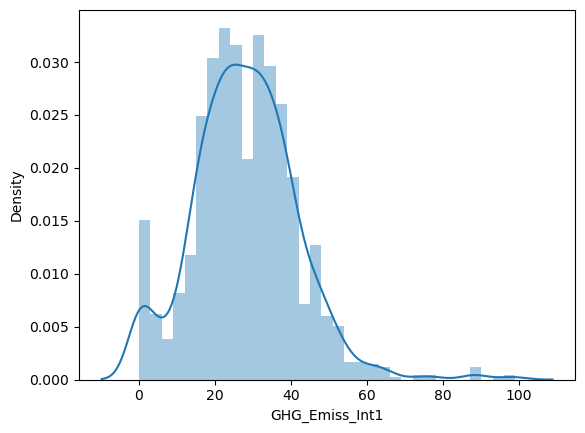

In [190]:
sns.distplot(test6['GHG_Emiss_Int1'])

In [188]:
test6 = test4[test4['GHG_Emiss_Int1'] < 100]

In [247]:
multifamilyhousing_counts = multifamilyhousing.groupby('Postal_Code').count()['PrimPropTypCalc'].reset_index()

In [248]:
# Create a base map
map_9 = folium.Map(location=[43.7226, -79.3671], 
                 tiles='openstreetmap',                 
                   zoom_start=11)

# Add a choropleth map to the base map
Choropleth(geo_data=test.__geo_interface__, # use 'plot_geography' for geographic data
            columns=['Postal_Code','PrimPropTypCalc'],           
            data=multifamilyhousing_counts,                           # use 'plot_data' ('station_density') to color the regions
            key_on='feature.id', 
            fill_color='YlOrRd', 
            legend_name='Multifamily Housing Counts'
            ).add_to(map_9)

# Display the map
map_9

(0.0, 4.0)

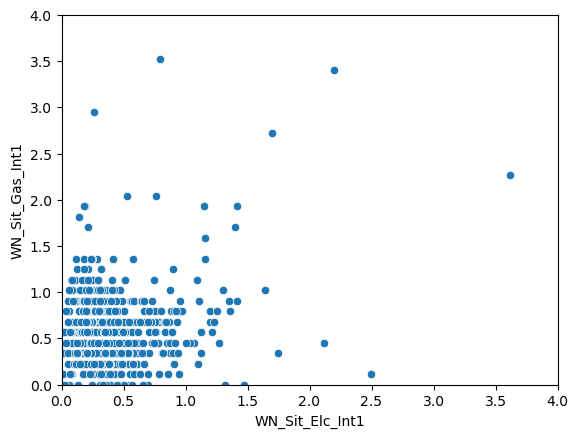

In [229]:
sns.scatterplot(x=test3['WN_Sit_Elc_Int1'],y=test3['WN_Sit_Gas_Int1'])
plt.xlim([0,4])
plt.ylim([0,4])

C:\Users\chait\AppData\Local\Temp\ipykernel_11448\849596425.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(all_datasets['Annual_electricity_generation_k'])


<Axes: xlabel='Annual_electricity_generation_k', ylabel='Density'>

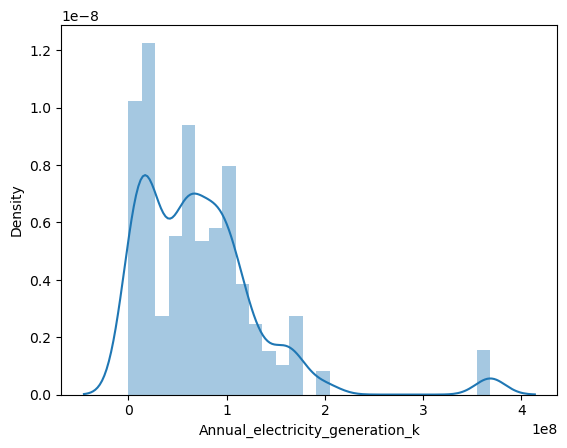

In [249]:
sns.distplot(all_datasets['Annual_electricity_generation_k'])